<a href="https://colab.research.google.com/github/akvavit01/fft_analyzer/blob/main/Tugas_Sinyal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Mount file from google drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Change directory

In [2]:
import os
os.chdir("drive/MyDrive/sample_sound")

List audio files

In [3]:
!ls "./raw"

'[ONTIVA.COM]-Scriabin - Etude Op. 8 No. 12-HQ.wav'   test_full.wav
'Robert Glasper - So Beautiful.wav'		      test.wav


In [4]:
!ls "./trimmed"

'[ONTIVA.COM]-Scriabin - Etude Op. 8 No. 12-HQ_trimmed.wav'   test_trimmed.wav
'Robert Glasper - So Beautiful_trimmed.wav'


Import libraries

In [5]:
import scipy.fft as fft
import scipy.io.wavfile as wavfile
import scipy.fftpack as fftpk

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import iplot

import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 

from IPython.display import Audio

%matplotlib inline

cf.go_offline()
init_notebook_mode(connected=False)

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [6]:
import plotly
print(plotly.__version__)

4.4.1


##Pipeline :

In [7]:
# For trimming audio file
def trim_wav( raw_s_rate, raw_signal, newWavPath , t_start, t_end ): # both t_start and t_end in second
    start_signal = int( t_start * raw_s_rate )
    end_signal = int( t_end * raw_s_rate )
    wavfile.write( newWavPath, raw_s_rate, raw_signal[start_signal:end_signal] )

###load file -> trim (if necessary) -> FFT -> define frequency vector -> plot

example below

Load raw audio

In [8]:
raw_file_path = r"raw/"
raw_file_name = r"test.wav"
raw_s_rate, raw_signal = wavfile.read(raw_file_path + raw_file_name)

In [9]:
Audio(filename="raw/test.wav")

Trim raw audio

In [10]:
# Load and trim raw file
trimmed_file_path = r"trimmed/"
trimmed_file_name = raw_file_name.replace(".wav", "_trimmed.wav")
trim_time = [10, 11]
trim_wav(raw_s_rate, raw_signal, 
         trimmed_file_path + trimmed_file_name, 
         trim_time[0], trim_time[1])

Load trimmed audio

In [11]:
s_rate, signal = wavfile.read(trimmed_file_path + trimmed_file_name)

In [12]:
Audio(filename="trimmed/test_trimmed.wav")

Plotting in time domain

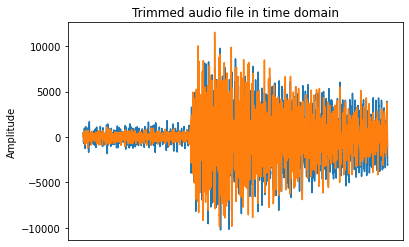

In [13]:
plt.plot(signal)
plt.tick_params(
    axis='x',
    which='both',
    bottom=False,
    top=False,
    labelbottom=False
)
plt.ylabel("Amplitude")
plt.title("Trimmed audio file in time domain")
plt.rcParams["figure.figsize"] = (10, 10)
plt.show()

Plotting in frequency domain

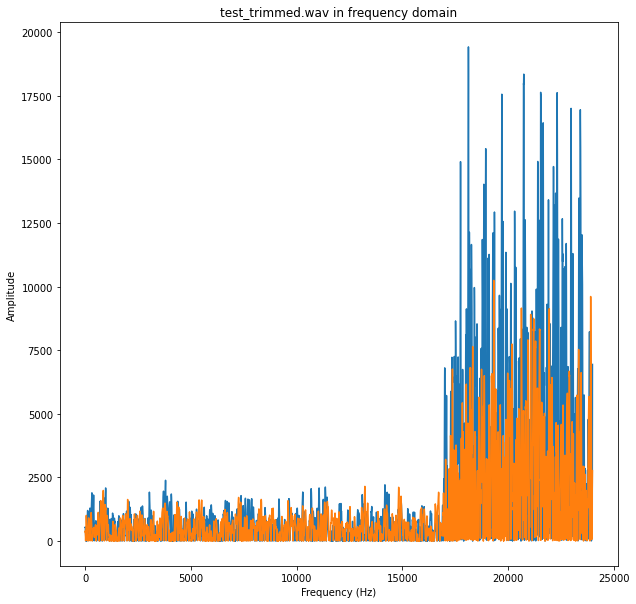

In [14]:
# FFT
FFT = abs(fft.fft(signal))

# Define frequency vector
freqs = fftpk.fftfreq(len(FFT), (1.0/s_rate))

# Plot result
plt.plot(freqs[range(len(FFT)//2) ], FFT[range(len(FFT)//2 ) ] )
plt.title(trimmed_file_name + " in frequency domain")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Amplitude")
plt.rcParams["figure.figsize"] = (10, 10)
plt.show()

In [15]:
# Storing data as numpy array
freq_ = np.array( freqs[range(len(FFT)//2) ] )
amp = np.array( FFT[range(len(FFT)//2 ) ] )

# Reshape frequency array
freq_ = freq_.reshape( (freq_.size, 1) )

# Convert numpy array to pandas dataframe
df1 = pd.DataFrame( freq_, columns=['Frequency'] )
df2 = pd.DataFrame( amp, columns=['Channel1', 'Channel2'] )

# Merge dataframes
df1['Channel1'] = df2['Channel1']
df1['Channel2'] = df2['Channel2']
df = df1

configure_plotly_browser_state()
df.iplot(kind='line', 
         title='FFT Result',
         xTitle='Frequency',
         yTitle='Amplitude',
         x='Frequency', 
         y=['Channel1', 'Channel2'], 
         color=['white', 'gold'], 
         theme='solar', 
         mode='lines')

plt.show()

In [16]:
import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import iplot

import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 

cf.go_offline()
init_notebook_mode(connected=False)

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))
  
'''df = pd.DataFrame({
    'month': ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'],
    'Year_2018': [3.26, 6.11, 4.86, 6.53, 4.45, 3.86, 8.04, 7.59, 1.48, 4.75, 7.27, 11.83],
    'Year_1996': [8.26, 3.82, 6.42, 2.91, 2.12, 1.70, 2.14, 4.66, 4.32, 0.89, 3.22, 4.14]
}
)
print(df.head())

configure_plotly_browser_state()
df.iplot(kind='line',x='month',y=['Year_2018', 'Year_1996'], color=['white', 'gold'], 
theme='solar', mode='lines',title='Annual Rainfall in the city Peachtree City, GA')'''

freq_ = np.array( freqs[range(len(FFT)//2) ] )
amp = np.array( FFT[range(len(FFT)//2 ) ] )

'''print( freq_ )
print( amp )

print(freq_.shape)
print(amp.shape)

print( freq_.reshape( (freq_.size, 1 ) ) )
print( amp )'''

freq_ = freq_.reshape( (freq_.size, 1) )
#print(freq_)

df1 = pd.DataFrame( freq_, columns=['Frequency'] )
#df['Amplitude'] = amp
#print(df1.head())

df2 = pd.DataFrame( amp, columns=['Channel1', 'Channel2'] )
#print(df2.head())

df1['Channel1'] = df2['Channel1']
df1['Channel2'] = df2['Channel2']
#print(df1.head())

df = df1
#print(df.head())

configure_plotly_browser_state()
df.iplot(kind='line',x='Frequency',y=['Channel1', 'Channel2'], color=['white', 'gold'], 
theme='solar', mode='lines',title='FFT Result')

plt.show()

## Real stuffs below

Check raw audios

In [17]:
!ls "./raw"

'[ONTIVA.COM]-Scriabin - Etude Op. 8 No. 12-HQ.wav'   test_full.wav
'Robert Glasper - So Beautiful.wav'		      test.wav


Load raw audio

In [18]:
raw_file_path = r"raw/"
raw_file_name = r"Robert Glasper - So Beautiful.wav"
raw_s_rate, raw_signal = wavfile.read(raw_file_path + raw_file_name)

Trim raw audio

In [19]:
# Load and trim raw file
trimmed_file_path = r"trimmed/"
trimmed_file_name = raw_file_name.replace(".wav", "_trimmed.wav")
trim_time = [8.5, 9.5]
trim_wav(raw_s_rate, raw_signal, 
         trimmed_file_path + trimmed_file_name, 
         trim_time[0], trim_time[1])

Check trimmed audio

In [20]:
!ls "./trimmed"

'[ONTIVA.COM]-Scriabin - Etude Op. 8 No. 12-HQ_trimmed.wav'   test_trimmed.wav
'Robert Glasper - So Beautiful_trimmed.wav'


Load trimmed audio

In [21]:
s_rate, raw_signal = wavfile.read(trimmed_file_path + trimmed_file_name)

In [22]:
Audio(filename=trimmed_file_path + trimmed_file_name)

Plotting trimmed audio in time domain

In [23]:
os.chdir('images')

FileNotFoundError: ignored

In [ ]:
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg')

# Time vector
t = np.arange(0, len(raw_signal)/s_rate, 1/s_rate)

plt.plot(t, raw_signal[:, 0], 'blue')
plt.plot(t, raw_signal[:, 1], 'red')
plt.xlabel('Waktu (detik)')
plt.ylabel('Amplitudo')
plt.title('Plot sampel pada domain waktu')
plt.legend(['Kanal 1', 'Kanal 2'])
plt.savefig('time_domain_raw.png', dpi=200)
plt.show()

Plotting trimmed audio in frequency domain

In [ ]:
# FFT
FFT = abs(fft.fft(raw_signal))

# Define frequency vector
freqs = fftpk.fftfreq(len(FFT), (1.0/s_rate))

# Plot result
plt.plot(freqs[:7902], FFT[:, 0][:7902], 'blue')
plt.plot(freqs[:7902], FFT[:, 1][:7902], 'red')
plt.xlabel('Frekuensi (Hz)')
plt.ylabel('Amplitudo')
plt.title('Plot sampel pada domain frekuensi')
plt.legend(['Kanal 1', 'Kanal 2'])
plt.savefig('freq_domain_raw.png', dpi=200)
plt.show()

# Windowing

In [ ]:
from scipy.signal.windows import hamming

window = hamming(len(raw_signal))
windowed_signal = np.array([signal*window for signal in raw_signal.T])

plt.plot(t, windowed_signal.T[:, 0], 'blue')
plt.plot(t, windowed_signal.T[:, 1], 'red')
plt.xlabel('Waktu (detik)')
plt.ylabel('Amplitudo')
plt.title('Plot sampel pada domain waktu dengan window Hamming')
plt.legend(['Kanal 1', 'Kanal 2'])
plt.savefig('time_domain_window.png', dpi=200)
plt.show()

In [ ]:
from scipy.signal import find_peaks

# FFT
FFT = abs(fft.fft(windowed_signal.T))

# Define frequency vector
freqs = fftpk.fftfreq(len(FFT), (1.0/s_rate))

# Find peaks
peaks1, _ = find_peaks(FFT[:, 0][:7902], height=0, distance=75)
peaks2, _ = find_peaks(FFT[:, 1][:7902], height=0, distance=75)

# Plot result
# plt.plot(freqs[:7902], FFT[:, 0][:7902])
# plt.plot(peaks, FFT[:, 0][peaks], 'x', c='r')
# plt.xlabel('Frekuensi (Hz)')
# plt.ylabel('Amplitudo')
# plt.title('Plot kanal 1 sampel pada domain frekuensi')
# # plt.savefig('FFT_windowing.png', dpi=200)
# plt.show()

fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(12.8, 4.8))
# Kanal 1
ax1.plot(freqs[:7902], FFT[:, 0][:7902], 'blue')
ax1.plot(peaks1, FFT[:, 0][peaks1], 'xk')
ax1.set_xlabel('Frekuensi (Hz)')
ax1.set_ylabel('Amplitudo')
ax1.set_title('Plot kanal 1 sampel pada domain frekuensi')
# Kanal 2
ax2.plot(freqs[:7902], FFT[:, 1][:7902], c='red')
ax2.plot(peaks2, FFT[:, 1][peaks2], 'xk')
ax2.set_xlabel('Frekuensi (Hz)')
ax2.set_ylabel('Amplitudo')
ax2.set_title('Plot kanal 2 sampel pada domain frekuensi')
plt.savefig('freq_domain_window.png', dpi=200)
fig.show()

In [ ]:
# plt.vlines(peaks, 0, FFT[:, 0][peaks])
# plt.title('Signal in frequency domain (peaks)')
# plt.xlabel('Frequency (Hz)')
# plt.ylabel('Amplitude')
# plt.savefig('FFT_windowing_peaks.png', dpi=200)
# plt.show()

fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(12.8, 4.8))
# Kanal 1
ax1.vlines(peaks1, 0, FFT[:, 0][peaks1], colors='blue')
ax1.set_xlabel('Frekuensi (Hz)')
ax1.set_ylabel('Amplitudo')
ax1.set_title('Plot garis frekuensi pada kanal 1')
# Kanal 2
ax2.vlines(peaks2, 0, FFT[:, 1][peaks2], colors='red')
ax2.set_xlabel('Frekuensi (Hz)')
ax2.set_ylabel('Amplitudo')
ax2.set_title('Plot garis frekuensi pada kanal 2')
plt.savefig('freq_domain_window_vline.png', dpi=200)
fig.show()

In [ ]:
for i, peak in enumerate(peaks2):
    # print('{:2d}\t{:4d}'.format(i+1, peak))
    print(peak)